# Farmland & Crops Angle Correct by EXIF
根據 [影像的 EXIF 資訊](https://stackoverflow.com/questions/13872331/rotating-an-image-with-orientation-specified-in-exif-using-python-without-pil-in) 修正角度

In [1]:
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

In [2]:
import cv2
from PIL import Image

In [3]:
def get_shape_from_pil(path):
    image = Image.open(path)
    width = image.size[0]
    height = image.size[1]
    return (width, height)

def get_shape_from_cv2(path):
    image = cv2.imread(path)
    height, width, channel = image.shape
    return (width, height)

In [4]:
def load_image_and_resize(path: str, new_size: int = 224, rotate: bool = False):
    """
    Use CV2 to read image, and resize the image to make the aspect ratio.  
    
    The resize method is fixed to padding and the padding method is fixed to constant.

    Arguments:
    ----------
        path (str): The image path.  
        
        new_size (int): The desired image size.  
        
        rotate (bool): Whether to rotate the image, the rotation angle is fixed at 270 degrees.

    Returns:
    --------
        image (3d-array): Image vector converted to rgb format.
    """
    image = cv2.imread(path)
    height, width, channel = image.shape
    # resize by ratio
    ratio = new_size / max(height, width)
    new_height, new_width = int(ratio * height), int(ratio * width)
    image = cv2.resize(image, (new_width, new_height))
    # calculate boundaries
    top, bottom = (new_size - new_height) // 2, (new_size - new_height) // 2
    left, right = (new_size - new_width) // 2, (new_size - new_width) // 2
    bottom = bottom + 1 if (top + bottom + height < new_size) else bottom
    right = right + 1 if (left + right + width < new_size) else right
    image = cv2.copyMakeBorder(image, top, bottom, left, right, cv2.BORDER_CONSTANT, value=0)
    image = cv2.rotate(image, cv2.ROTATE_90_COUNTERCLOCKWISE) if rotate else image
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image

In [5]:
# Top level data directory. Here we assume the format of the directory conforms to the ImageFolder structure
path = "."

# Folder of the training data
training_folder = 'D:/Dataset/aidea-farmland-crops-autumn/train'

# Image size for model
image_size = 112

In [6]:
data = pd.read_csv(F"{path}/train_image_angle_mark_sample.csv")
labels = data.groupby('label').count().reset_index()['label']

## View
當 CV2 與 PIL 取出來的寬高不同時，表示 PIL 有讀到角度的 EXIF 資訊

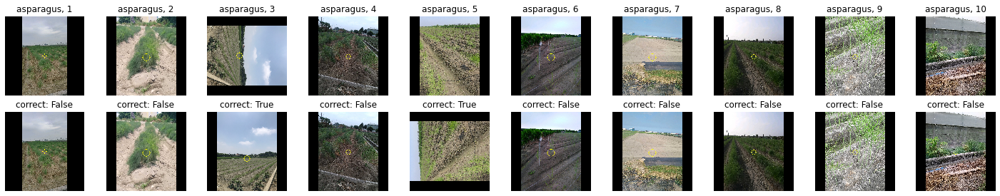

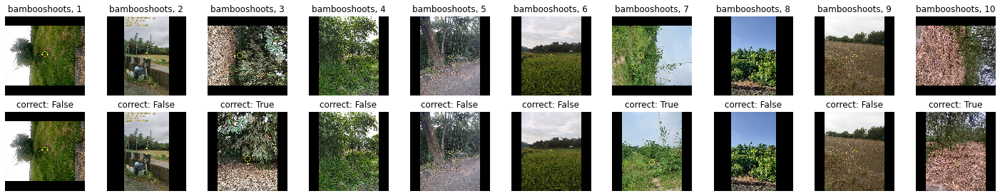

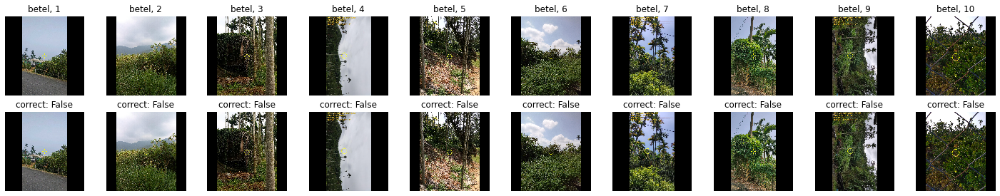

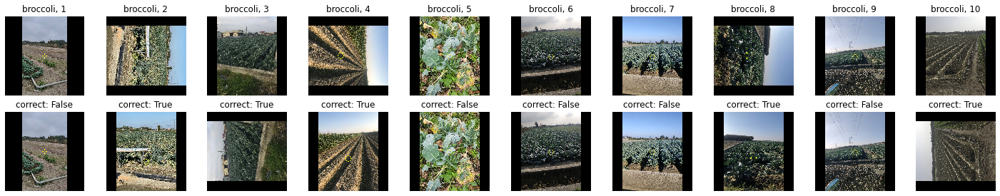

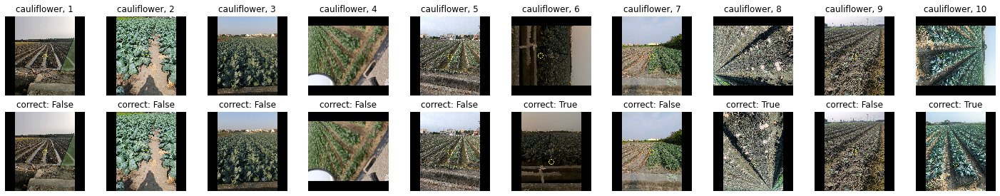

...

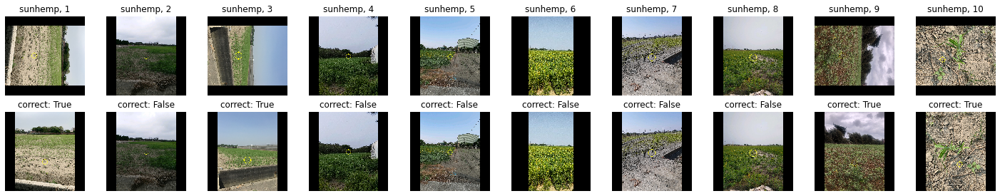

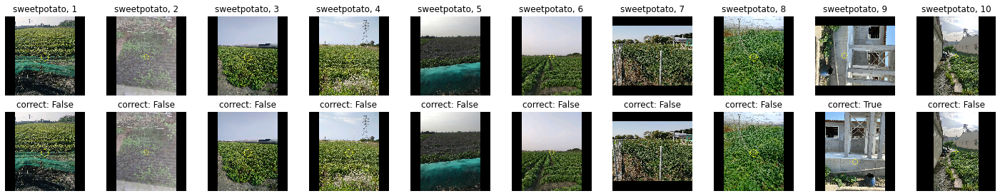

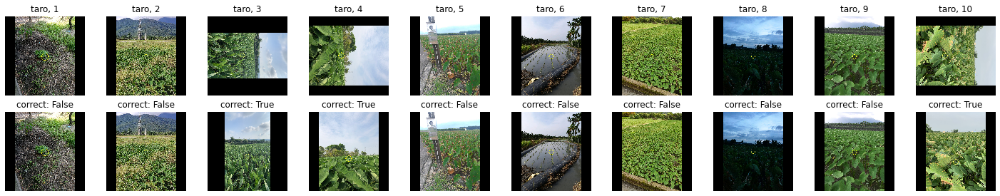

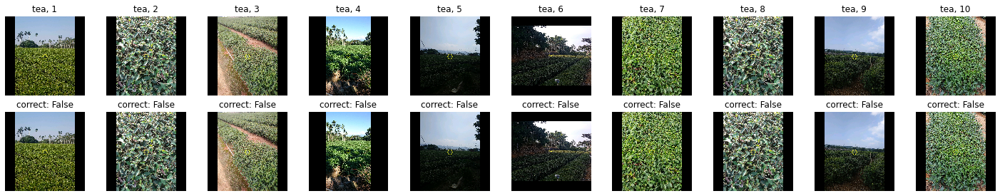

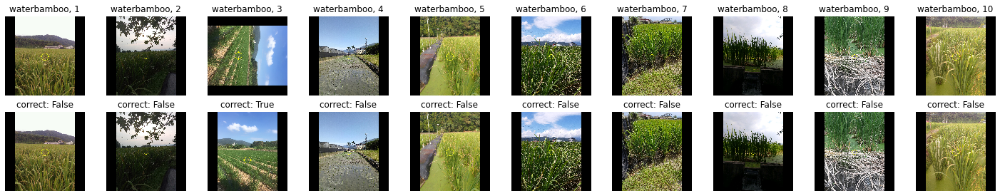

In [22]:
def row_based_idx(num_rows, num_cols, idx):
    return np.arange(1, num_rows*num_cols + 1).reshape((num_rows, num_cols)).transpose().flatten()[idx-1]

items = 10
variants = 1
for label in labels:
    plt.figure(figsize=(items * 2.5, variants * 4.5))
    filter_by_label = data[data['label'].eq(label)].reset_index(drop=True)
    for idx in range(items):
        row = filter_by_label.iloc[idx]
        filepath = F'{training_folder}/{row["label"]}/{row["file"]}'
        shape_from_pil = get_shape_from_pil(filepath)
        shape_from_cv2 = get_shape_from_cv2(filepath)
        original = load_image_and_resize(filepath, image_size, rotate=False)
        correct = load_image_and_resize(filepath, image_size, rotate=shape_from_pil != shape_from_cv2)
        # plot: original
        ax = plt.subplot((variants + 1), items, row_based_idx((variants + 1), items, idx * (variants + 1) + 1))
        plt.imshow(original)
        plt.title("{}, {}".format(row["label"], idx + 1))
        plt.axis('off')
        # plot: correct
        ax = plt.subplot((variants + 1), items, row_based_idx((variants + 1), items, idx * (variants + 1) + 2))
        plt.imshow(correct)
        plt.title("correct: {}".format(shape_from_pil != shape_from_cv2))
        plt.axis('off')
    plt.show()

## Result
肉眼標記修正結果，以計算修正成效，結果 precision、recall 與 f1-score 皆大於 0.9，顯示效果不錯

In [7]:
from sklearn.metrics import classification_report

def evaluate(y_true, y_pred,zero_division = 1):
    labels = sorted(list(set(y_true + y_pred)))
    eval_result = classification_report(
        y_true, y_pred, target_names=labels, 
        output_dict=True, zero_division=zero_division
    )
    return eval_result

In [9]:
data = pd.read_csv(F"{path}/train_image_angle_mark_sample.csv")
pd.DataFrame(evaluate(data['angle'].tolist(), data['correct.rule'].tolist())).T

,precision,recall,f1-score,support
0,0.946721,0.939024,0.942857,246.000000
90,1.000000,0.000000,0.000000,5.000000
180,1.000000,0.000000,0.000000,1.000000
270,0.813953,0.897436,0.853659,78.000000
accuracy,0.912121,0.912121,0.912121,0.912121
macro avg,0.940169,0.459115,0.449129,330.000000
weighted avg,0.916309,0.912121,0.904631,330.000000
